In [10]:
from dash import Dash, dcc, html, Input, Output
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import pandas as pd
import sys
import numpy as np
import matplotlib.pyplot as plt


n_cells = 1000
dir_name = "/home/nelly/Documents/MSU/git/CP_5th_course/Godunov_solver/results/piston/amplitude_dependency/time_100/piston__1000__100.00__0.20__50.00__25.00__2.50"
data_dir = dir_name + "/data/"


In [2]:
data = pd.read_csv(data_dir + 'piston_r_u_p.txt', delimiter='\t', names=['r', 'u', 'p', 't'])
data['x'] = data.index
length = int(len(data.index) / n_cells)

GAMMA = 5. / 3
c_v = 8.31 / (GAMMA - 1)
data['s'] = 1 + c_v * np.log(data['p'] / (data['r'] ** GAMMA))
data['Mach'] = data['u'] / np.sqrt(GAMMA * data['p']/ data['r'])


def data_step(i):
    return data.iloc[i * n_cells: (i + 1) * n_cells]


app = Dash(__name__)

fig = make_subplots(rows=2, cols=2)
for step in np.arange(0, length - 1):
    # fig.add_trace(go.Scatter(x=data_step(step).x, y=data_step(step).r,  name='density'), 1, 1)
    fig.add_trace(row=1, col=1, trace=
    go.Scatter(
        visible=step == 0,
        line=dict(color="blue", width=3),
        name="density",
        x=data_step(step).x,
        y=data_step(step).r,
    ))
    fig.add_trace(row=1, col=2, trace=
    go.Scatter(
        visible=step == 0,
        line=dict(color="green", width=3),
        name="velocity",
        x=data_step(step).x,
        y=data_step(step).u,
    ))
    fig.add_trace(row=2, col=1, trace=
    go.Scatter(
        visible=step == 0,
        line=dict(color="red", width=3),
        name="pressure",
        x=data_step(step).x,
        y=data_step(step).p,
    ))
    fig.add_trace(row=2, col=2, trace=
    go.Scatter(
        visible=step == 0,
        line=dict(color="purple", width=3),
        name="Mach",
        x=data_step(step).x,
        y=data_step(step).Mach,
    ))
    # times.append(str(data_step(step)["t"].iloc[0]))

    # fig.add_trace(go.Scatter(x=data_step(step).x, y=data_step(step).u,  name='k(x)=cos(x)'), 1, 2)

window_length = 5

steps = []
for i in range(0, len(fig.data), 4):
    step = dict(
        method="restyle",
        # args=["visible", [False] * len(fig.data)],
        args=[
            # Make the ith trace visible
            {'visible': [False] * len(fig.data)},

            # Set the title for the ith trace
            {'title.text': 'Step %d' % i}],
        label=str(data_step(i // 4)["t"].iloc[0])
    )
    # print(step["args"][0]["visible"][i:i + 1])
    step["args"][0]["visible"][i:i + 1] = [True, True, True, True]
    steps.append(step)
    # fig.frames[]['layout'].update(title_text=f'My title {i}')

    sliders = [dict(
        active=0,
        currentvalue={"prefix": "Time: ",
                      "suffix": " seconds",
                      "font": {"size": 25}},
        pad={"t": 50},
        steps=steps
    )]

title_font_size = 22
ticks_font_size = 20

fig['layout']['xaxis'].update(range=[data.x.min() - 0.05, data.x.max() + 0.05], title_text='x',
                              title_font={"size": title_font_size},
                              tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))
fig['layout']['yaxis'].update(range=[data.r.min() - 0.05, data.r.max() + 0.05], title_text='density',
                              title_font={"size": title_font_size},
                              tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))
fig['layout']['xaxis2'].update(range=[data.x.min() - 0.05, data.x.max() + 0.05], title_text='x',
                               title_font={"size": title_font_size},
                               tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))
fig['layout']['yaxis2'].update(range=[data.u.min() - 0.05, data.u.max() + 0.05], title_text='velocity',
                               title_font={"size": title_font_size},
                               tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))
fig['layout']['xaxis3'].update(range=[data.x.min() - 0.05, data.x.max() + 0.05], title_text='x',
                               title_font={"size": title_font_size},
                               tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))
fig['layout']['yaxis3'].update(range=[data.p.min() - 0.05, data.p.max() + 0.05], title_text='pressure',
                               title_font={"size": title_font_size},
                               tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))
fig['layout']['xaxis4'].update(range=[data.x.min() - 0.05, data.x.max() + 0.05], title_text='x',
                               title_font={"size": title_font_size},
                               tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))
fig['layout']['yaxis4'].update(range=[data.Mach.min() - 0.05, data.Mach.max() + 0.05], title_text='Mach',
                               title_font={"size": title_font_size},
                               tickfont=dict(family='Rockwell', color='black', size=ticks_font_size))

fig.update_layout(
    sliders=sliders,
)

fig.show()

# chart_studio.tools.set_credentials_file(username='Nelly_125', api_key='IKyJ5ipPVE30cYXcOkyz')
# py.plot(fig, filename = 'file', auto_open=True)


In [180]:
import matplotlib.pyplot as plt


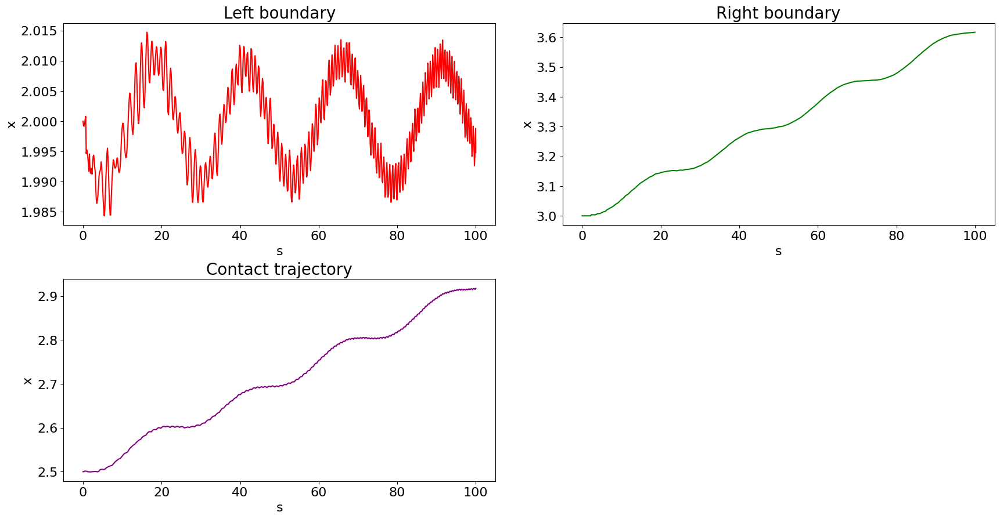

In [181]:
fig = plt.figure(figsize=(18, 10))
ax1 = fig.add_subplot(221)
ax2 = fig.add_subplot(222)
ax3 = fig.add_subplot(223)

for ax in [ax1, ax2, ax3]:
    ax.set_xlabel("s", fontsize=16)
    ax.set_ylabel("x", fontsize=16)
# ax4 = fig.add_subplot(224)

fig.tight_layout(pad=0.4, h_pad=4, w_pad=4)
plt.subplots_adjust(top=0.85, left=0.1, bottom=0.06)

for a in [ax1, ax2, ax3]:
    for label in (a.get_xticklabels() + a.get_yticklabels()):
        label.set_fontsize(16)

trajectories_data = pd.read_csv(data_dir + "trajectories.txt", delimiter="\t", names=["t", "left", "diaph", "right"])

ax1.plot(trajectories_data["t"], trajectories_data["left"], color='red')
ax1.set_title("Left boundary", fontsize=20)
ax2.plot(trajectories_data["t"], trajectories_data["right"], color='green')
ax2.set_title("Right boundary", fontsize=20)
ax3.plot(trajectories_data["t"], trajectories_data["diaph"], color='purple')
ax3.set_title("Contact trajectory", fontsize=20)

# plt.tick_params(axis='both', which='major', labelsize=17)

plt.show()


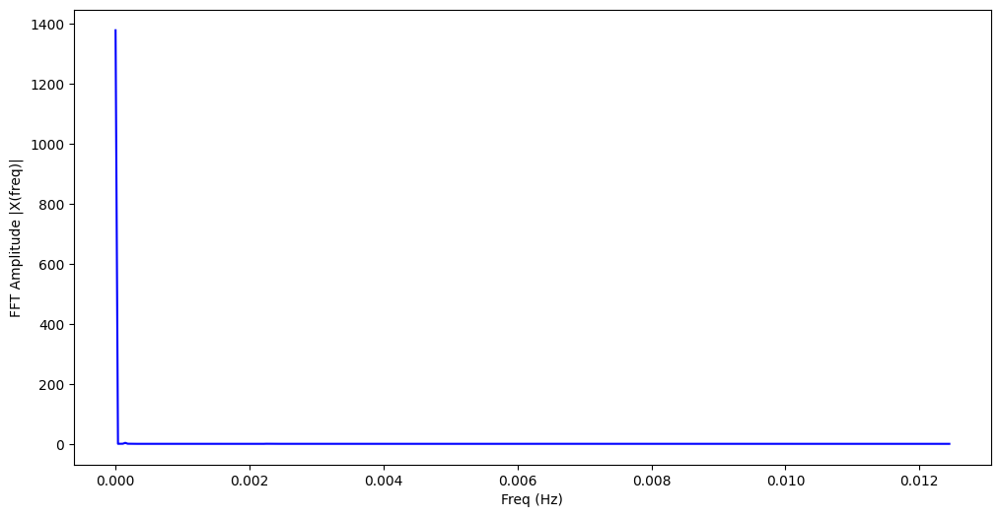

In [182]:
from scipy.fftpack import fft, ifft

x = trajectories_data["left"].to_numpy()
X = fft(x)
N = len(X)
n = np.arange(N)
sr = 1 / (40)
T = N/sr
freq = n/T 
n_oneside = N//2
f_oneside = freq[:n_oneside]

plt.figure(figsize = (12, 6))
plt.plot(f_oneside, np.abs(X[:n_oneside]), 'b')
plt.xlabel('Freq (Hz)')
plt.ylabel('FFT Amplitude |X(freq)|')
plt.show()

/home/nelly/.local/lib/python3.8/site-packages/matplotlib/cbook/__init__.py:1369: ComplexWarning:

Casting complex values to real discards the imaginary part



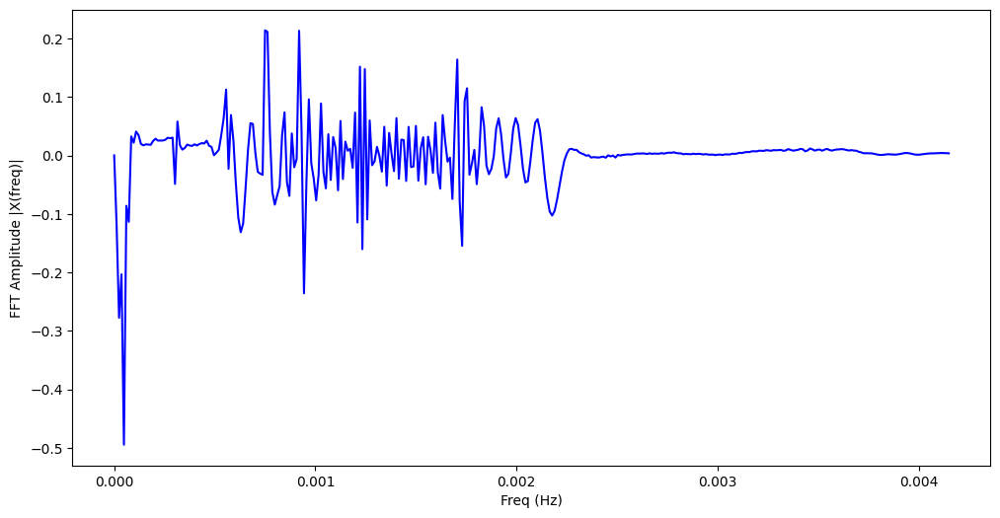

In [183]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

Pressure = trajectories_data["left"]
frate = 1. / 120
Pfft = np.fft.fft(Pressure)
Pfft[0] = 0

freqs = np.fft.fftfreq(len(Pfft), 1. / frate)
N = len(Pfft)
plt.figure(figsize = (12, 6))
plt.plot(freqs[:N//2], Pfft[:N//2], color="b")
plt.xlabel('Freq (Hz)')
plt.ylabel('FFT Amplitude |X(freq)|')
plt.show()

In [3]:
density_df = data[["t", "x", "r"]].copy()

In [40]:
import matplotlib.tri as tri


for k in range(len(data)):
    if k % 1000 == 0:
        continue
    else:
        data["t"].iloc[k] = data_step(k // 1000)["t"].iloc[0]

xi = np.linspace(data.x.min() - 0.05, data.x.max() + 0.05, 100)
yi = np.linspace(data.t.min() - 0.05, data.t.max() + 0.05, 100)


triang = tri.Triangulation(data.x, data.t)
interpolator = tri.LinearTriInterpolator(triang, data.r)
Xi, Yi = np.meshgrid(xi, yi)
zi = interpolator(Xi, Yi)



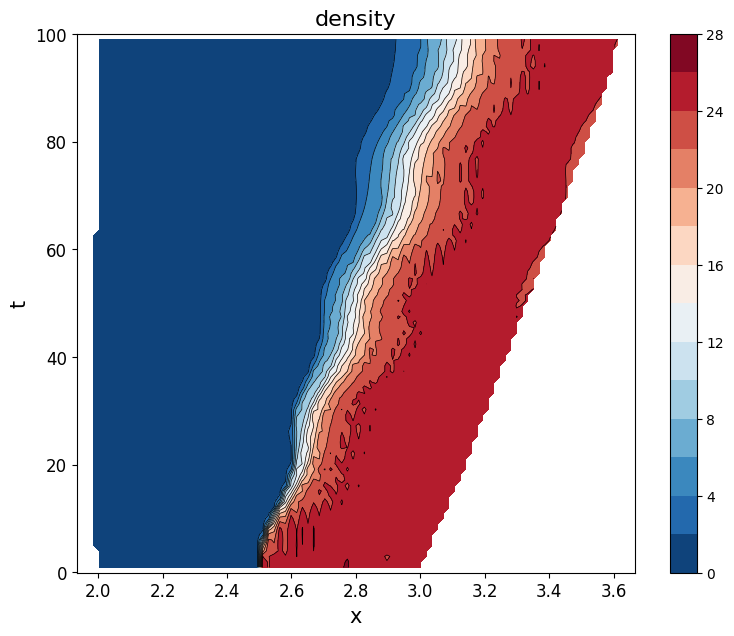

In [59]:
fig, ax = plt.subplots(figsize=(9, 7))
ax.contour(xi, yi, zi, levels=14, linewidths=0.5, colors='k')
cntr1 = ax.contourf(xi, yi, zi, levels=14, cmap="RdBu_r")

fig.colorbar(cntr1, ax=ax)
ax.set_xlabel("x", fontsize=15)
ax.set_ylabel("t", fontsize=15)
plt.title("density", fontsize=16)
ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=12)

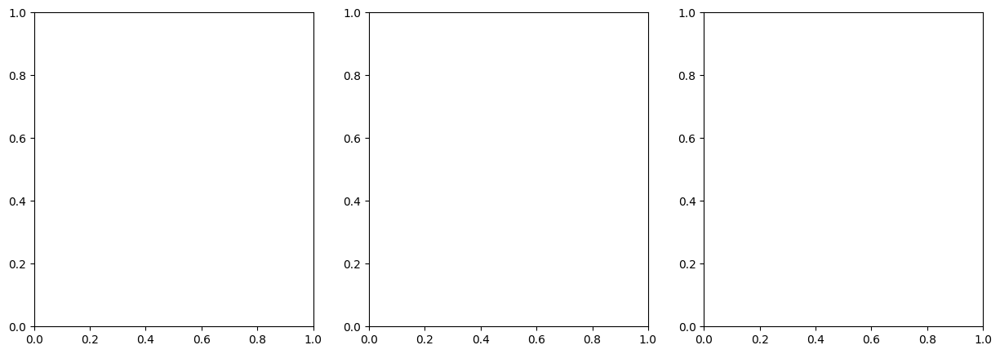

In [62]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15, 5))


In [28]:
from scipy.interpolate import griddata

grid_x = np.linspace(density_df.x.min() - 0.05, density_df.x.max() + 0.05, 100)
grid_y = np.linspace(density_df.t.min() - 0.05, density_df.t.max() + 0.05, 100)

grid_z0 = griddata((density_df.x, density_df.t), density_df.r, (grid_x, grid_y), method='nearest')
grid_z0 = griddata((density_df.x, density_df.t), density_df.r, (grid_x, grid_y), method='linear')
grid_z0 = griddata((density_df.x, density_df.t), density_df.r, (grid_x, grid_y), method='cubic')